# Install Detectron2 Dependencies

In [1]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8MB 27kB/s 
     |████████████████████████████████| 6.6MB 32.2MB/s 
ERROR: torchtext 0.9.1 has requirement torch==1.8.1, but you'll have torch 1.5.0+cu101 which is incompatible.
  Found existing installation: torch 1.8.1+cu101
    Uninstalling torch-1.8.1+cu101:
      Successfully uninstalled torch-1.8.1+cu101
  Found existing installation: torchvision 0.9.1+cu101
    Uninstalling torchvision-0.9.1+cu101:
      Successfully uninstalled torchvision-0.9.1+cu101
     |████████████████████████████████| 276kB 7.2MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44074 sha256=977ce585cf5c9b50bd7bd9dc0c97bf258514f3969a7f14c657b1fe99bb80210c
  Stored in directory: /root/.cache/pip/wheels/ad/56/bc/1522f864feb2a358ea6f1a92b4798d69ac783a28e80567a18b
Successfully built pyyaml
  Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.1

In [2]:
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2MB 4.6MB/s 
     |████████████████████████████████| 51kB 4.5MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20210518-cp37-none-any.whl size=60362 sha256=980a02a8d36d599a85656b130cb0e5e616578fedd49203def70972fddf089f8b
  Stored in directory: /root/.cache/pip/wheels/3b/0e/15/f134f13f031ac5f3973892c54513a5df360f92749fef15e7bd
Successfully built fvcore


In [3]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Custom Detectron2 Data

In [7]:
!curl -L "https://app.roboflow.com/ds/TNlXpBYfKJ?key=IbgBLkmfBw" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   887  100   887    0     0   1268      0 --:--:-- --:--:-- --:--:--  1267
100 9812k  100 9812k    0     0  7708k      0  0:00:01  0:00:01 --:--:--  223M
Archive:  roboflow.zip
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/_annotations.coco.json  
 extracting: test/complete-blood-count_jpg.rf.e24eb1dcc2bc2732ab1609a18325e30c.jpg  
 extracting: test/cultural-examination-of-blood-2_jpg.rf.57a38802767c409b34f99448472ff8a0.jpg  
   creating: train/
 extracting: train/24-hours-urinary-protiens_jpg.rf.158cb7f00b185b42a1a36551c95b85c2.jpg  
 extracting: train/24-hours-urinary-protiens_jpg.rf.394d7de7b0c90ac75381c5c285f5e4d6.jpg  
 extracting: train/24-hours-urinary-protiens_jpg.rf.dbc66637c1334a511efed187806da42d.jpg  
 extracting: train/24-hrs--urine-albumin_jpg.rf.70cd6c709bcaad208b6e7a6bc3f70a04.jpg  


In [8]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


AssertionError: ignored

WARNING [05/22 13:14:03 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/22 13:14:03 d2.data.datasets.coco]: Loaded 51 images in COCO format from /content/train/_annotations.coco.json


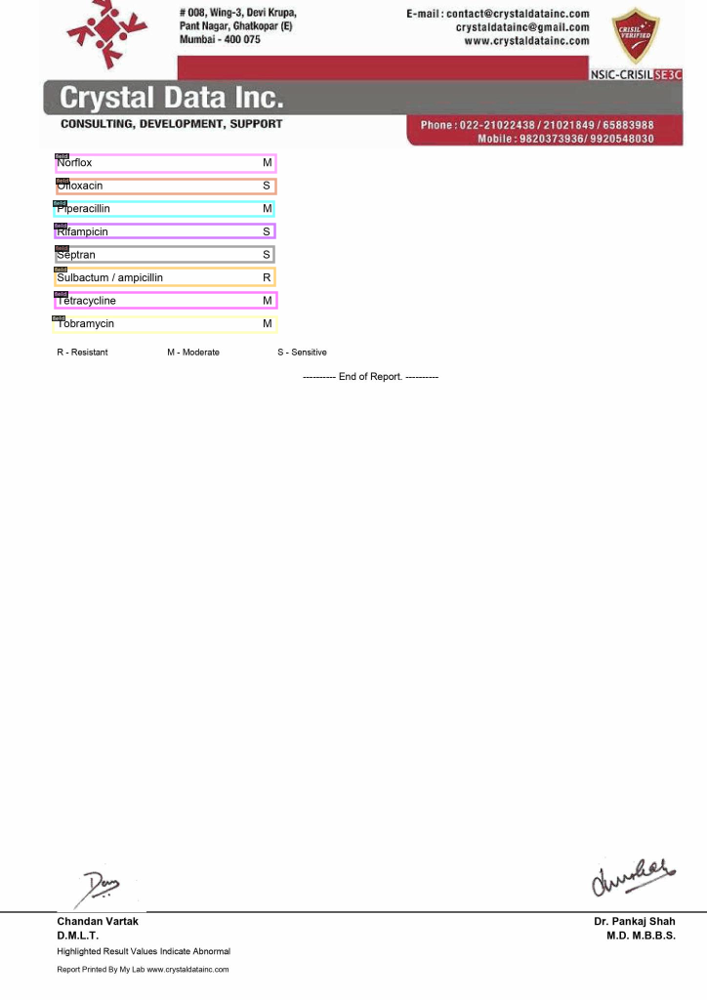

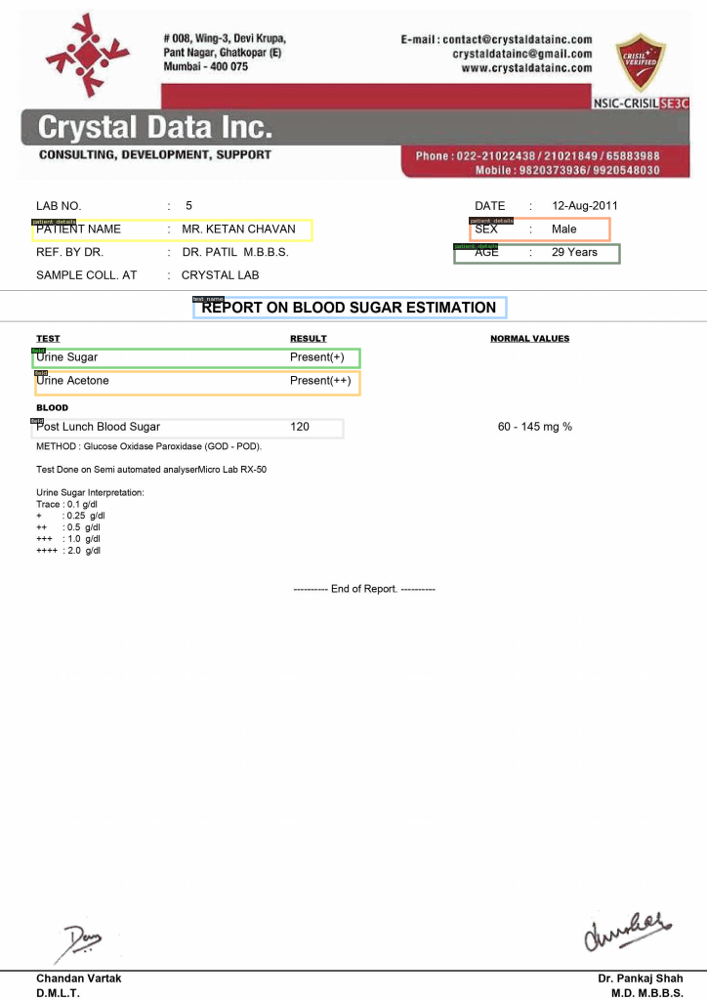

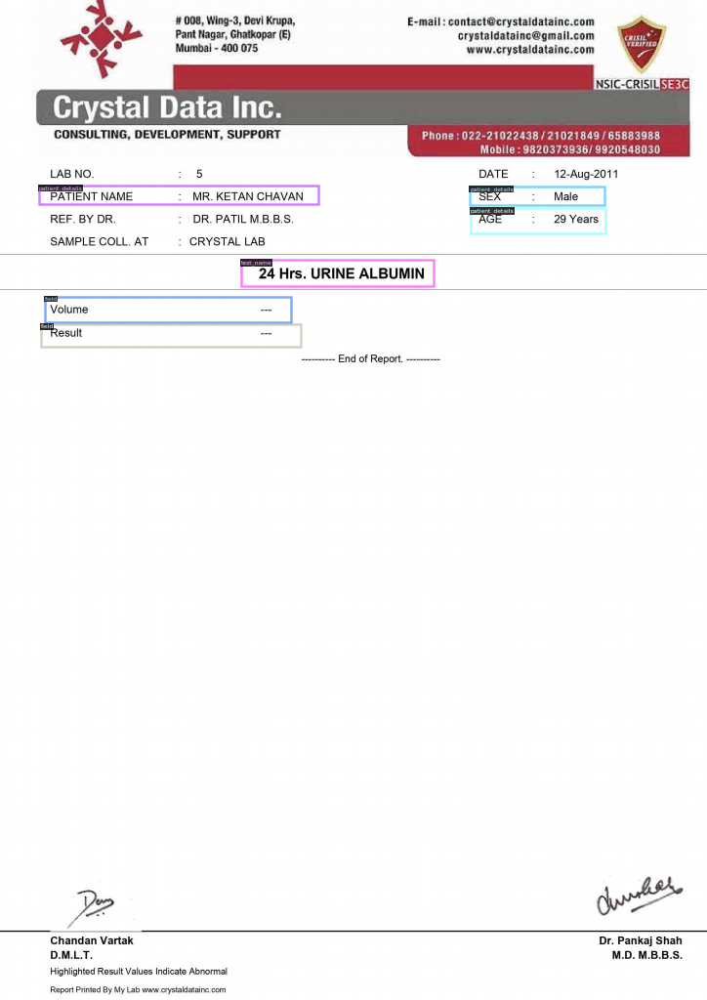

In [9]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [10]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [11]:
#from .detectron2.tools.train_net import Trainer
from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os




cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)
cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_101_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.MAX_ITER = 1500
cfg.MODEL.ROI_HEADS.NUM_CLASSES =4 

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=True)
trainer.train()



[05/22 13:14:21 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f6e8b1.pkl: 243MB [00:04, 59.3MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (5, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (5,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (16, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (16,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_p

[05/22 13:14:28 d2.engine.train_loop]: Starting training from iteration 0
[05/22 13:14:53 d2.utils.events]:  eta: 0:30:51  iter: 19  total_loss: 1.889  loss_cls: 1.075  loss_box_reg: 0.160  loss_rpn_cls: 0.310  loss_rpn_loc: 0.466  time: 1.2497  data_time: 0.0500  lr: 0.000400  max_mem: 5981M
[05/22 13:15:21 d2.utils.events]:  eta: 0:32:33  iter: 39  total_loss: 0.995  loss_cls: 0.316  loss_box_reg: 0.203  loss_rpn_cls: 0.142  loss_rpn_loc: 0.314  time: 1.3191  data_time: 0.0097  lr: 0.000799  max_mem: 5981M
[05/22 13:15:48 d2.utils.events]:  eta: 0:32:37  iter: 59  total_loss: 0.888  loss_cls: 0.294  loss_box_reg: 0.324  loss_rpn_cls: 0.069  loss_rpn_loc: 0.227  time: 1.3419  data_time: 0.0122  lr: 0.001199  max_mem: 5981M
[05/22 13:16:18 d2.utils.events]:  eta: 0:33:03  iter: 79  total_loss: 1.022  loss_cls: 0.304  loss_box_reg: 0.436  loss_rpn_cls: 0.037  loss_rpn_loc: 0.235  time: 1.3792  data_time: 0.0114  lr: 0.001598  max_mem: 5982M
[05/22 13:16:49 d2.utils.events]:  eta: 0:33:2

In [12]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [13]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [05/22 13:53:31 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/22 13:53:31 d2.data.datasets.coco]: Loaded 2 images in COCO format from /content/test/_annotations.coco.json
[05/22 13:53:31 d2.data.build]: Distribution of instances among all 4 categories:
|  category  | #instances   |  category  | #instances   |   category    | #instances   |
|:----------:|:-------------|:----------:|:-------------|:-------------:|:-------------|
|   field    | 0            |   field    | 20           | patient_det.. | 3            |
| test_name  | 1            |            |              |               |              |
|   total    | 24           |            |              |               |              |
[05/22 13:53:31 d2.data.common]: Serializing 2 elements to byte tensors and concatenating them all ...
[05/22 13:53:31 d2.data.common]: Serialized dataset takes 0.00 MiB
[05/22 13:53:31 d2.evaluation.evaluator]: Start infe

OrderedDict([('bbox',
              {'AP': 77.36521605542312,
               'AP-field': 54.30686928838156,
               'AP-patient_details': 77.7887788778878,
               'AP-test_name': 99.99999999999997,
               'AP50': 91.90103935375676,
               'AP75': 89.99224761723612,
               'APl': 79.78545807962553,
               'APm': 69.99999999999999,
               'APs': nan})])

# Inference with Detectron2 Saved Weights



In [14]:
%ls ./output/

coco_instances_results.json                       last_checkpoint
events.out.tfevents.1621689263.73cbd7f740d7.58.0  metrics.json
instances_predictions.pth                         model_final.pth


In [15]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

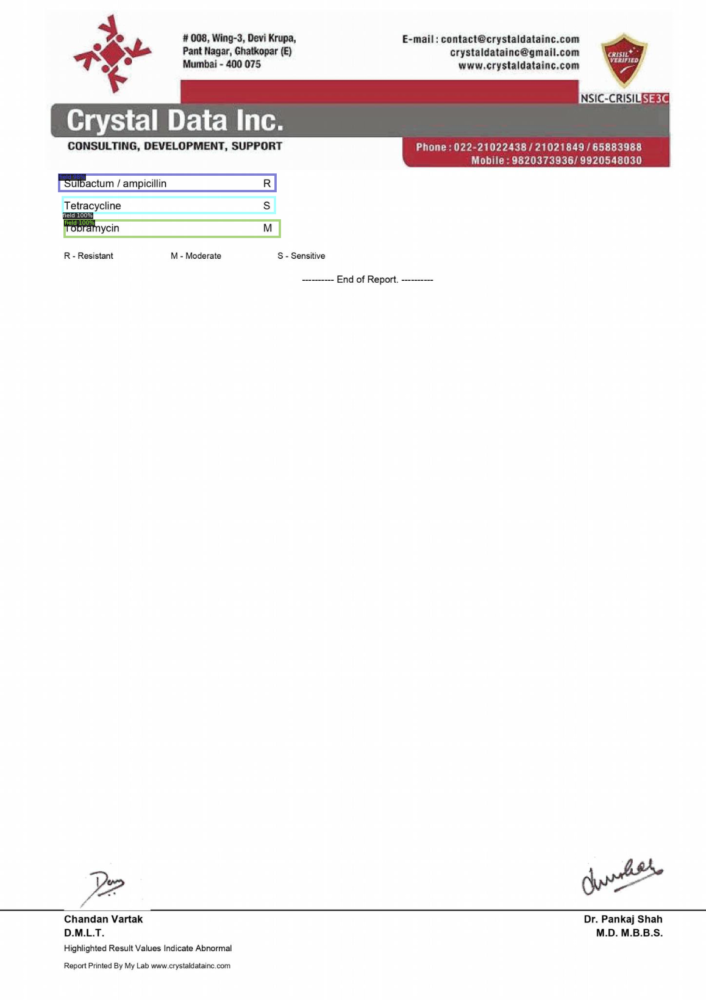

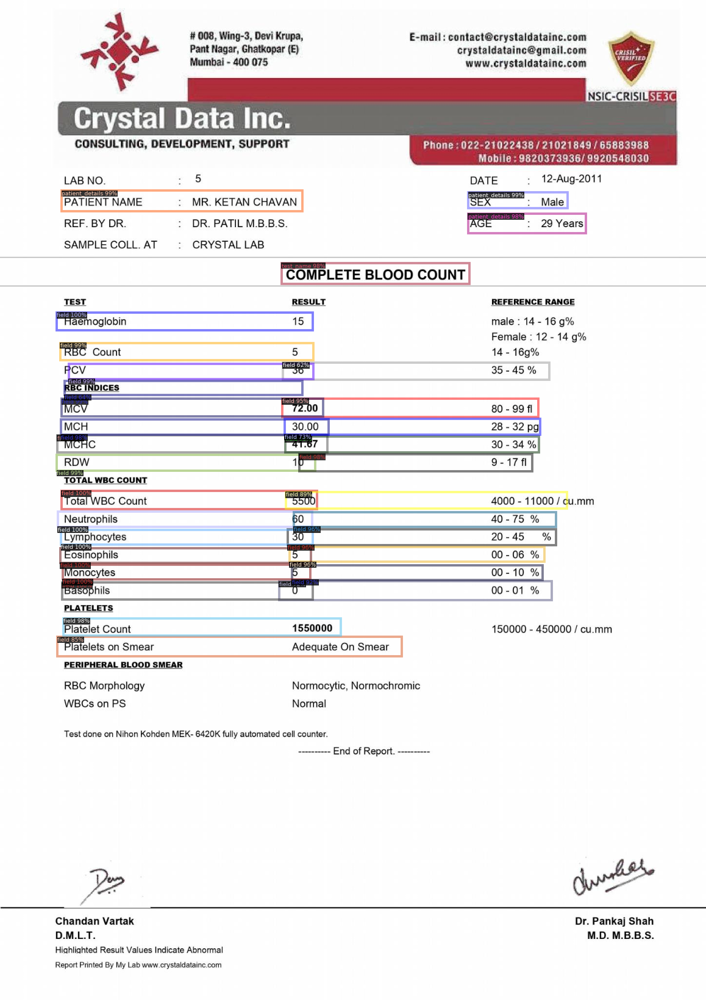

In [16]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])


In [17]:
im2 = cv2.imread('/content/train/cultural-examination-of-blood-1_jpg.rf.44e2880673e1343e9f3d070f63b3a49a.jpg')

In [ ]:
cv2_imshow(im2)

In [ ]:

outputs = predictor(im2)
v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [27]:
from google.colab import files

In [ ]:
files.download('/content/output')

In [30]:
! du -sh /content/output/model_final.pth

460M	/content/output/model_final.pth


In [31]:
from google.colab import drive
drive.mount('drive')

Mounted at drive


In [33]:
!cp -r  output "drive/My Drive/Saved Models-colab/"

In [22]:
import matplotlib.pyplot as plt

{'instances': Instances(num_instances=31, image_height=2048, image_width=1448, fields=[pred_boxes: Boxes(tensor([[ 116.7448,  640.9717,  641.2816,  677.5223],
        [ 127.6739, 1193.7229,  640.8138, 1227.9055],
        [ 128.6392, 1157.6511,  636.0526, 1187.2181],
        [ 124.0160, 1123.4647,  637.0888, 1153.2653],
        [ 125.6483, 1006.0851,  649.8799, 1043.6331],
        [ 118.6602, 1048.8367,  639.9937, 1079.8792],
        [ 125.5650, 1085.4773,  641.5677, 1115.7314],
        [ 123.3346,  703.3768,  642.5596,  738.4693],
        [ 126.6599,  391.8962,  620.2515,  433.8761],
        [ 960.4205,  395.1805, 1163.2673,  427.5362],
        [ 126.6036,  817.7792,  662.5172,  853.2980],
        [ 116.6225,  932.3549,  646.2864,  964.1622],
        [ 585.0990,  894.7878, 1104.8564,  927.6121],
        [ 140.6389,  746.5077,  642.4151,  776.9821],
        [ 117.2250,  892.5636,  671.7097,  927.4799],
        [ 125.3943,  860.2529,  673.4269,  891.2552],
        [ 960.1218,  439.0522, 

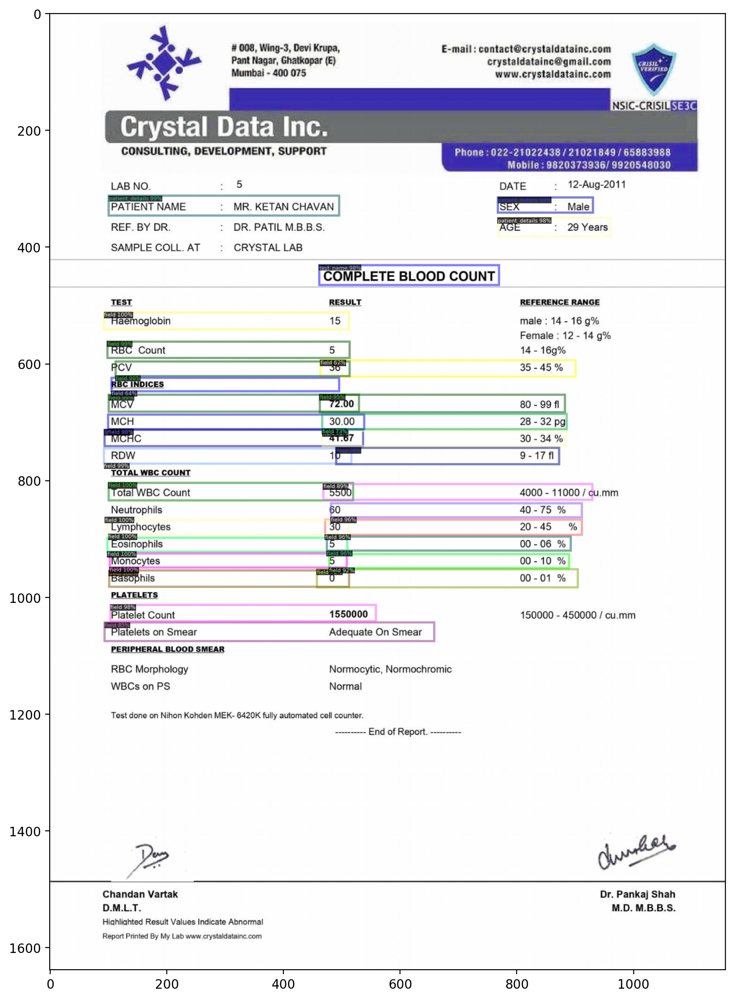

In [26]:
im = cv2.imread("/content/test/complete-blood-count_jpg.rf.e24eb1dcc2bc2732ab1609a18325e30c.jpg")
outputs = predictor(im)
print(outputs)
v = Visualizer(im[:, :, ::-1], metadata=test_metadata, scale=0.8)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
plt.figure(figsize = (22, 14), dpi=200)
plt.imshow(v.get_image()[:, :, ::-1])
plt.show()